In [1]:
import torch
import snntorch as snn

from snntorch import surrogate
from torch import nn
import numpy as np
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader
from PIL import Image,ImageEnhance
import torch.optim as optim
import os
from tqdm import tqdm
import time
from torch.cuda.amp import GradScaler, autocast
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim 


In [2]:
# Set device
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(device)

cuda


In [3]:
# Custom Dataset for grayscale and color images
class ColorizationDataset(Dataset):
    def __init__(self, grayscale_dir, color_dir, transform=None):
        self.grayscale_dir = grayscale_dir
        self.color_dir = color_dir
        self.transform = transform
        self.grayscale_images = sorted(os.listdir(grayscale_dir))
        self.color_images = sorted(os.listdir(color_dir))

    def __len__(self):
        return len(self.grayscale_images)

    def __getitem__(self, idx):
        gray_img_path = os.path.join(self.grayscale_dir, self.grayscale_images[idx])
        color_img_path = os.path.join(self.color_dir, self.color_images[idx])

        gray_image = Image.open(gray_img_path).convert("L")
        color_image = Image.open(color_img_path)

        if self.transform:
            gray_image = self.transform(gray_image)
            color_image = self.transform(color_image)

        # Ensure grayscale image has a single channel dimension
        gray_image = gray_image.unsqueeze(0) if gray_image.dim() == 2 else gray_image

        return gray_image, color_image

In [4]:
# # Function to load images from a folder
# def load_images_from_folder(folder_path, target_size=(128, 128), mode='RGB'):
#     images = []
#     cnt = 0
#     if os.path.isdir(folder_path):
#         for filename in os.listdir(folder_path):
#             img_path = os.path.join(folder_path, filename)
#             try:
#                 img = Image.open(img_path).convert(mode)
#                 img = img.resize(target_size)
#                 img_array = np.array(img) / 255.0  # Normalize to [0, 1]
#                 images.append(img_array)
#                 cnt += 1
#                 if cnt == 5000:  # Limit for testing purposes
#                     break
#             except Exception as e:
#                 print(f"Could not process {img_path}: {e}")
#     return np.array(images)

# # Custom Dataset
# class ColorizationDataset(Dataset):
#     def __init__(self, grayscale_dir, color_dir, transform=None, brightness_factor=0.5, contrast_factor=1.5):
#         self.grayscale_dir = grayscale_dir
#         self.color_dir = color_dir
#         self.transform = transform
#         self.brightness_factor = brightness_factor
#         self.contrast_factor = contrast_factor
        
#         # Load grayscale and color images
#         self.grayscale_images = load_images_from_folder(grayscale_dir, mode='L')
#         self.color_images = load_images_from_folder(color_dir, mode='RGB')

#     def __len__(self):
#         return len(self.grayscale_images)

#     def __getitem__(self, idx):
#         # Get grayscale and color images
#         gray_image = self.grayscale_images[idx]
#         color_image = self.color_images[idx]
        
#         # Convert numpy arrays to PIL Images
#         gray_image = Image.fromarray((gray_image * 255).astype(np.uint8)).convert('L')
#         color_image = Image.fromarray((color_image * 255).astype(np.uint8)).convert('RGB')

#         # Adjust brightness and contrast for color images
#         enhancer = ImageEnhance.Brightness(color_image)
#         color_image = enhancer.enhance(self.brightness_factor)
#         enhancer = ImageEnhance.Contrast(color_image)
#         color_image = enhancer.enhance(self.contrast_factor)

#         # Apply transformations if any
#         if self.transform:
#             gray_image = self.transform(gray_image)
#             color_image = self.transform(color_image)

#         # Adding an extra dimension for the grayscale image (single channel)
#         gray_image = gray_image.unsqueeze(0) if gray_image.dim() == 2 else gray_image

#         return gray_image, color_image

In [5]:

def visualize_results(model, test_loader, num_images=5):
    model.eval()
    with torch.no_grad():
        gray_images, color_images = next(iter(test_loader))
        gray_images = gray_images.to(device)
        color_images = color_images.to(device)

        outputs = model(gray_images)

        gray_images = gray_images.cpu().numpy()
        color_images = color_images.cpu().numpy()
        outputs = outputs.cpu().numpy()

        fig, axes = plt.subplots(num_images, 3, figsize=(15, 5 * num_images))
        for i in range(num_images):
            axes[i, 0].imshow(gray_images[i, 0], cmap="gray")
            axes[i, 0].set_title("Grayscale Input")
            axes[i, 1].imshow(color_images[i].transpose(1, 2, 0))
            axes[i, 1].set_title("Target Color")
            axes[i, 2].imshow(outputs[i].transpose(1, 2, 0))
            axes[i, 2].set_title("Model Output")
        plt.show()


In [6]:
#Define transformations with resize and minor augmentations
transform = transforms.Compose([
    transforms.Resize((180,180)),
    # transforms.RandomHorizontalFlip(p=0.3),
    # transforms.RandomVerticalFlip(p=0.3),
    # transforms.RandomRotation(degrees=10),
    transforms.ToTensor(),
    transforms.Normalize((0.4,), (0.4,))
])


In [7]:
# 

In [8]:
# Create dataset instances
train_dataset = ColorizationDataset(
    grayscale_dir='Colorization_Main/Colorization_Main/data/train_black',
    color_dir='Colorization_Main/Colorization_Main/data/train_color',
    transform=transform,
    # color_transform=color_transform
)

test_dataset = ColorizationDataset(
    grayscale_dir='Colorization_Main/Colorization_Main/data/test_black',
    color_dir='Colorization_Main/Colorization_Main/data/test_color',
    transform=transform,
    # color_transform=color_transform
)
# train_size = int(0.4 * len(train_dataset))
# test_size = len(train_dataset) - train_size
# train_dataset, test_dataset = torch.utils.data.random_split(train_dataset, [train_size, test_size])



In [9]:

# Create DataLoader instances
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=0)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False, num_workers=0)


In [10]:
# Print the shapes of images from DataLoader to verify
for gray_imgs, color_imgs in train_loader:
    print(f"Grayscale images shape: {gray_imgs.shape}") 
    print(f"Color images shape: {color_imgs.shape}")     
    break

Grayscale images shape: torch.Size([32, 1, 180, 180])
Color images shape: torch.Size([32, 3, 180, 180])


In [11]:
class ColorizationModel(nn.Module):
    def __init__(self):
        super(ColorizationModel, self).__init__()

        # Encoder
        self.encoder_conv1 = nn.Conv2d(1, 64, kernel_size=3, stride=1, padding=1)
        self.encoder_bn1 = nn.BatchNorm2d(64)
        self.encoder_lif1 = snn.Leaky(beta=0.9, threshold=1.0, spike_grad=surrogate.fast_sigmoid())

        self.encoder_conv2 = nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1)
        self.encoder_bn2 = nn.BatchNorm2d(128)
        self.encoder_lif2 = snn.Leaky(beta=0.9, threshold=1.0, spike_grad=surrogate.fast_sigmoid())

        self.encoder_conv3 = nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1)
        self.encoder_bn3 = nn.BatchNorm2d(256)
        self.encoder_lif3 = snn.Leaky(beta=0.9, threshold=1.0, spike_grad=surrogate.fast_sigmoid())

        # Decoder
        self.decoder_conv1 = nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.decoder_bn1 = nn.BatchNorm2d(128)

        self.decoder_conv2 = nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.decoder_bn2 = nn.BatchNorm2d(64)

        self.decoder_conv3 = nn.Conv2d(64, 3, kernel_size=3, stride=1, padding=1)
        self.output_activation = nn.Sigmoid()  # Outputs in range [0, 1]

        # Skip Connections
        self.skip_conv1 = nn.Conv2d(64, 64, kernel_size=1)
        self.skip_conv2 = nn.Conv2d(128, 128, kernel_size=1)
        # self.skip_conv3 = nn.Conv2d(3,3, kernel_size=1)

    def forward(self, x):
        # Initialize membrane potentials for spiking layers
        mem1 = self.encoder_lif1.init_leaky()
        mem2 = self.encoder_lif2.init_leaky()
        mem3 = self.encoder_lif3.init_leaky()

        # Encoder
        skip1 = self.encoder_bn1(self.encoder_conv1(x))
        spk1, mem1 = self.encoder_lif1(skip1, mem1)
        skip2 = self.encoder_bn2(self.encoder_conv2(spk1))
        spk2, mem2 = self.encoder_lif2(skip2, mem2)
        x = self.encoder_bn3(self.encoder_conv3(spk2))
        spk3, mem3 = self.encoder_lif3(x, mem3)

        # Decoder
        x = self.decoder_bn1(self.decoder_conv1(spk3))
        x += self.skip_conv2(skip2)  # Add skip connection
        x = self.decoder_bn1(self.decoder_conv1(spk3))
        

        x = self.decoder_bn2(self.decoder_conv2(x))
        x += self.skip_conv1(skip1)  # Add skip connection

        x = self.decoder_conv3(x)
        x = self.output_activation(x)  # Output in range [0, 1]

        return x


In [12]:
model = ColorizationModel().to(device)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4) 
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7647059..1.0686275].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.98039216..1.352941].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7647059..1.0392157].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.5].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.97058827..1.5].


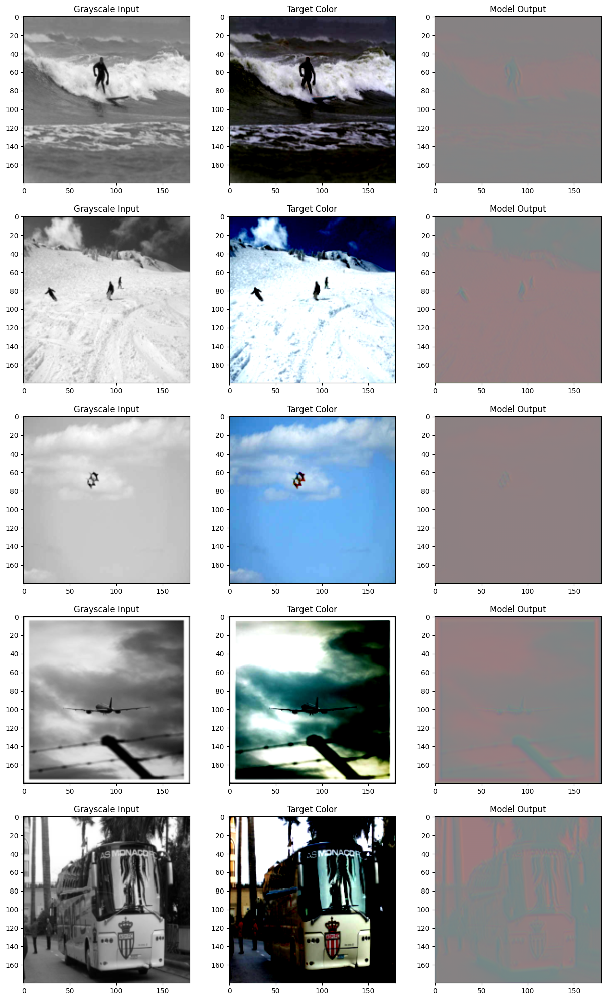

In [ ]:
visualize_results(model, train_loader, num_images=5)

In [14]:
class EarlyStopping:
    def __init__(self, patience=5, min_delta=0.001):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = None

    def step(self, loss):
        if self.best_loss is None or loss < self.best_loss - self.min_delta:
            self.best_loss = loss
            self.counter = 0
        else:
            self.counter += 1
        return self.counter >= self.patience

In [15]:

# 10. Metrics Calculation: PSNR and SSIM
def compute_metrics(outputs, targets):
    psnr_total = 0
    ssim_total = 0
    batch_size = outputs.size(0)
    
    for i in range(batch_size):
        output_img = outputs[i].permute(1, 2, 0).cpu().numpy()
        target_img = targets[i].permute(1, 2, 0).cpu().numpy()
        
        # PSNR expects images in [0, 1], which they are due to ToTensor()
        psnr_val = psnr(target_img, output_img, data_range=1.0)
        psnr_total += psnr_val
        
        # SSIM with multichannel=True
        ssim_val = ssim(target_img, output_img, multichannel=True, data_range=1.0)
        ssim_total += ssim_val
        
    avg_psnr = psnr_total / batch_size
    avg_ssim = ssim_total / batch_size
    return avg_psnr, avg_ssim

In [16]:
torch.cuda.empty_cache()

In [17]:
# 11. Training Loop with Mixed Precision
scaler = GradScaler()
num_epochs = 50
early_stopping = EarlyStopping(patience=5, min_delta=0.001)


C:\Users\psono\AppData\Local\Temp\ipykernel_17908\1453815291.py:2: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()


In [18]:
class PerceptualLoss(nn.Module):
    def __init__(self):
        super(PerceptualLoss, self).__init__()
        # Use a pre-trained VGG model for feature extraction
        vgg = model.vgg16(pretrained=True).features[:16].to(device)
        for param in vgg.parameters():
            param.requires_grad = False
        self.vgg = vgg
        self.mse_loss = nn.MSELoss()

    def forward(self, output, target):
        # Color loss (pixel-wise)
        color_loss = self.mse_loss(output, target)
        
        # Perceptual loss using VGG features
        output_features = self.vgg(output)
        target_features = self.vgg(target)
        perceptual_loss = self.mse_loss(output_features, target_features)
        
        # Combined loss with weighting
        return color_loss + 0.1 * perceptual_loss

# Early Stopping
class EarlyStopping:
    def __init__(self, patience=5, min_delta=0.001):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = float('inf')
        self.early_stop = False

    def __call__(self, val_loss):
        if val_loss < self.best_loss - self.min_delta:
            self.best_loss = val_loss
            self.counter = 0
        else:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        return self.early_stop

# Metrics Computation
def compute_metrics(outputs, targets):
    psnr_total = 0
    ssim_total = 0
    batch_size = outputs.size(0)
    
    for i in range(batch_size):
        output_img = outputs[i].permute(1, 2, 0).detach().cpu().numpy()
        target_img = targets[i].permute(1, 2, 0).detach().cpu().numpy()
        
        # Compute PSNR
        psnr_val = psnr(target_img, output_img, data_range=1.0)
        psnr_total += psnr_val
        
        # Compute SSIM
        ssim_val = ssim(target_img, output_img, 
                        data_range=1.0, 
                        multichannel=True)
        ssim_total += ssim_val
        
    avg_psnr = psnr_total / batch_size
    avg_ssim = ssim_total / batch_size
    return avg_psnr, avg_ssim



C:\Users\psono\AppData\Local\Temp\ipykernel_17908\4231584268.py:15: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Epoch [1/100], Loss: 0.2479


C:\Users\psono\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\torch\optim\lr_scheduler.py:240: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)


Epoch [2/100], Loss: 0.2034
Epoch [3/100], Loss: 0.1994
Epoch [4/100], Loss: 0.1992
Epoch [5/100], Loss: 0.1976
Visualizing results after Epoch 5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.98039216..1.4803922].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.5].


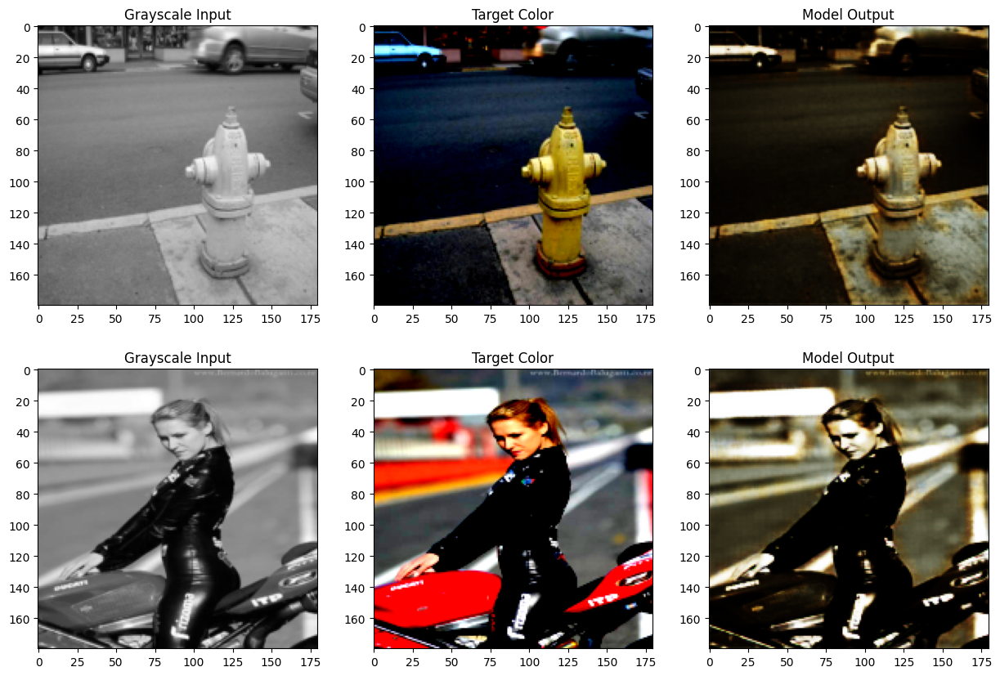

Epoch [6/100], Loss: 0.1976
Epoch [7/100], Loss: 0.1975
Epoch [8/100], Loss: 0.1961
Epoch [9/100], Loss: 0.1967
Epoch [10/100], Loss: 0.1967
Visualizing results after Epoch 10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9901961..1.5].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.5].


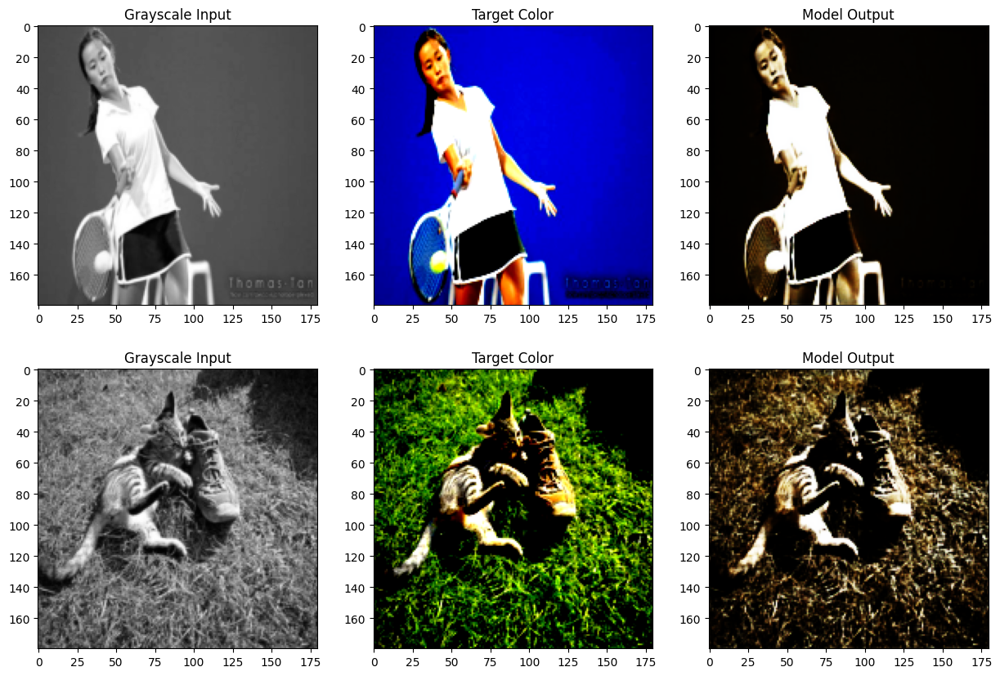

Epoch [11/100], Loss: 0.1970
Epoch [12/100], Loss: 0.1961
Epoch [13/100], Loss: 0.1958
Epoch [14/100], Loss: 0.1963
Epoch [15/100], Loss: 0.1955
Visualizing results after Epoch 15


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.5].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7647059..1.0392157].


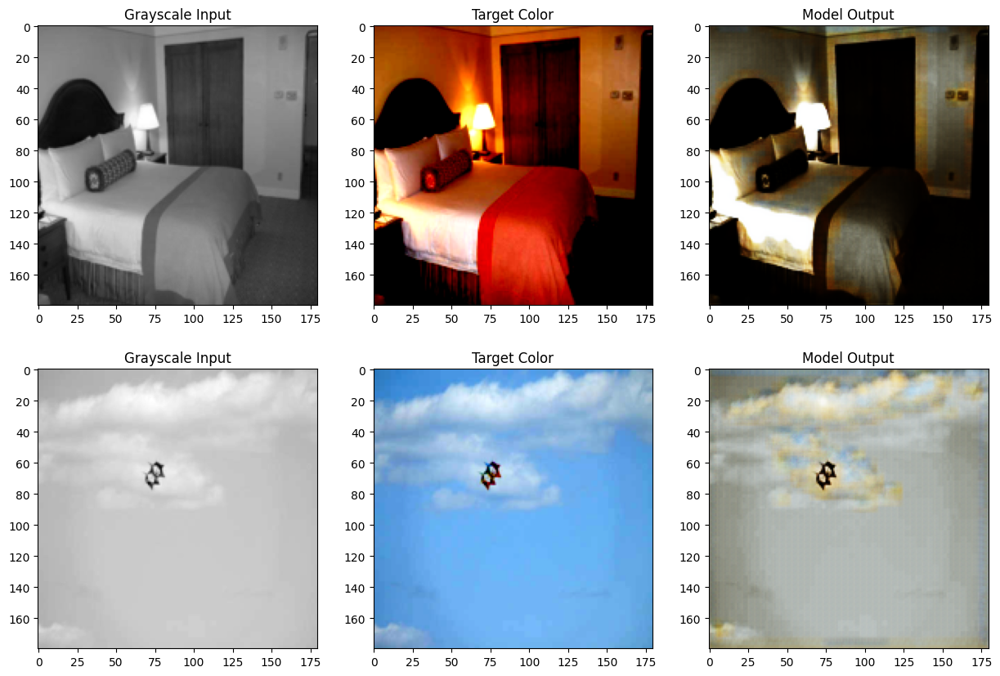

Epoch [16/100], Loss: 0.1953
Epoch [17/100], Loss: 0.1954
Epoch [18/100], Loss: 0.1952
Epoch [19/100], Loss: 0.1953
Epoch [20/100], Loss: 0.1951
Visualizing results after Epoch 20


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.5].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.5].


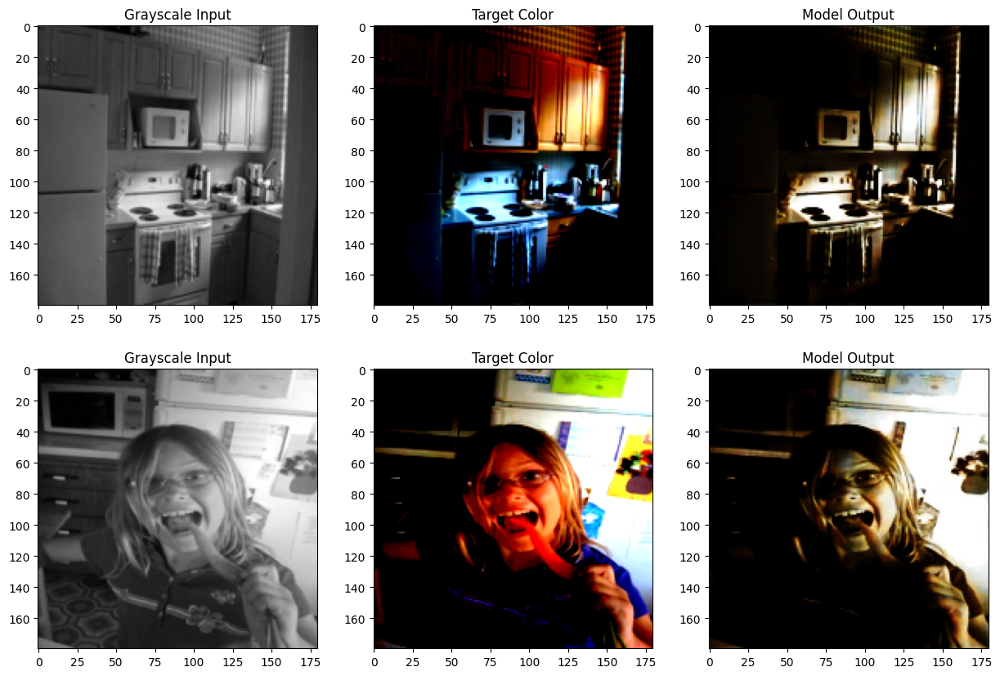

Epoch [21/100], Loss: 0.1953
Epoch [22/100], Loss: 0.1946
Epoch [23/100], Loss: 0.1946
Epoch [24/100], Loss: 0.1949
Epoch [25/100], Loss: 0.1943
Visualizing results after Epoch 25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9901961..1.5].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.4803922].


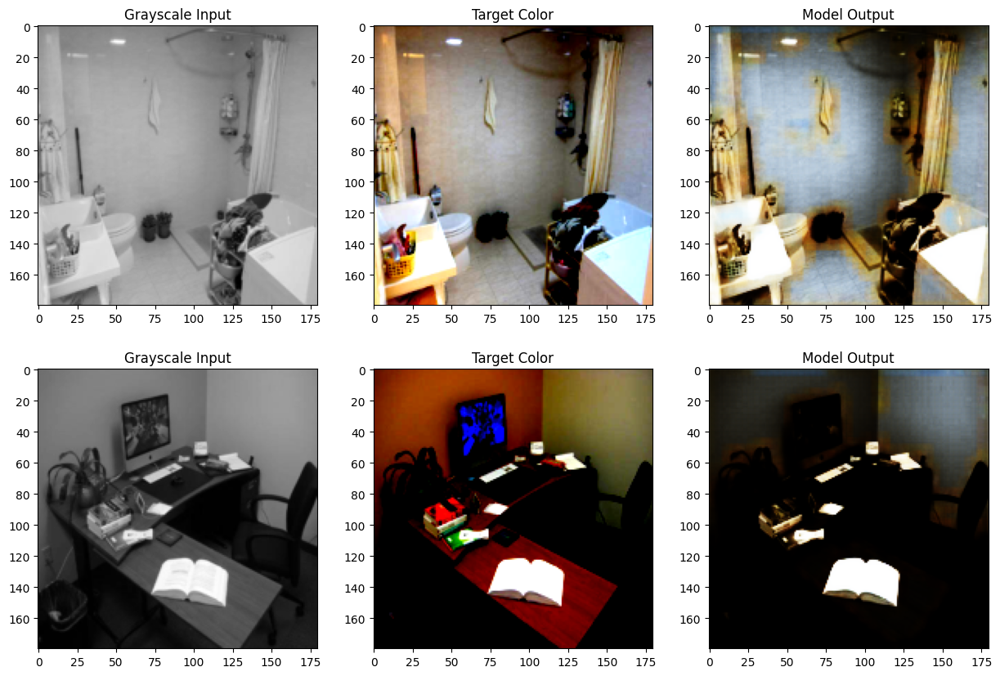

Epoch [26/100], Loss: 0.1942
Epoch [27/100], Loss: 0.1951
Epoch [28/100], Loss: 0.1945
Epoch [29/100], Loss: 0.1946
Epoch [30/100], Loss: 0.1942
Visualizing results after Epoch 30


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.98039216..1.5].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.5].


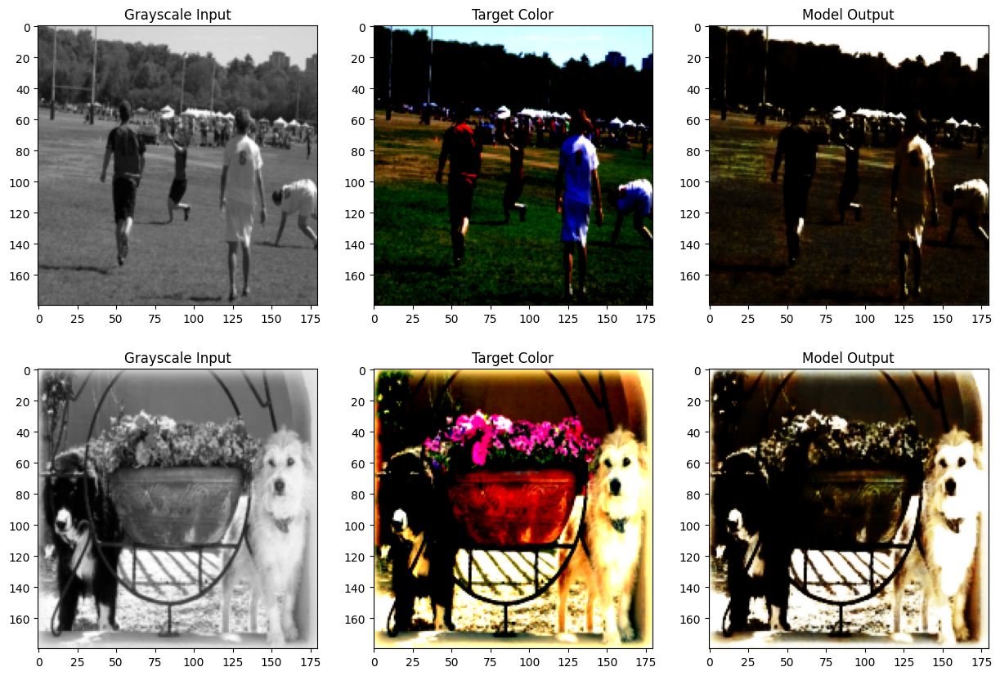

Epoch [31/100], Loss: 0.1942
Epoch [32/100], Loss: 0.1946
Epoch [33/100], Loss: 0.1952
Epoch [34/100], Loss: 0.1947
Epoch [35/100], Loss: 0.1941
Visualizing results after Epoch 35


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.490196].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9901961..1.4803922].


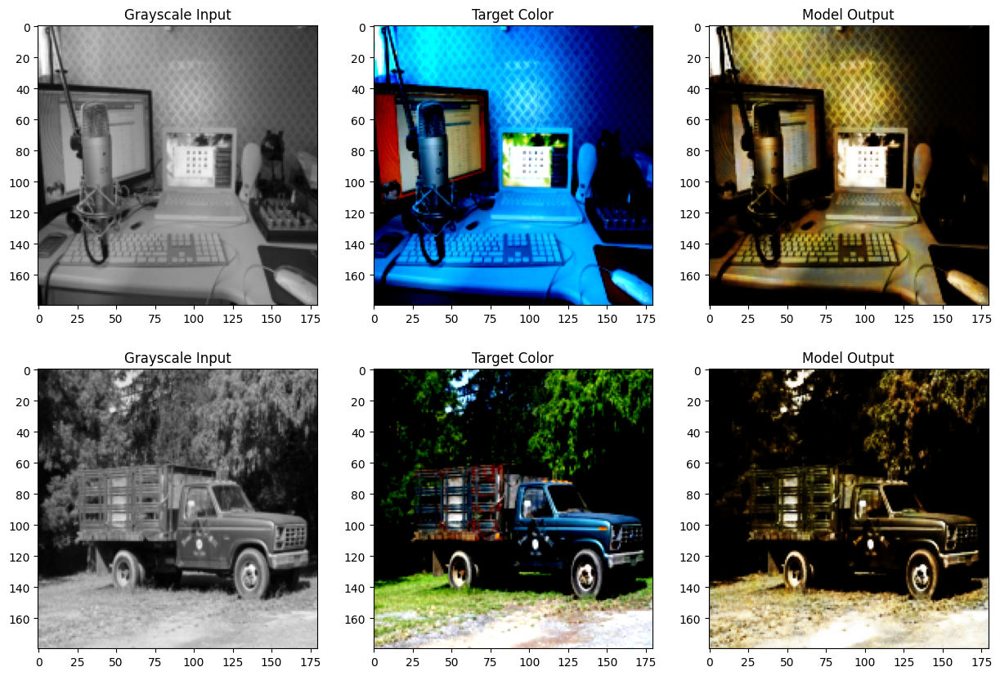

Epoch [36/100], Loss: 0.1944
Epoch [37/100], Loss: 0.1945
Epoch [38/100], Loss: 0.1940
Epoch [39/100], Loss: 0.1947
Epoch [40/100], Loss: 0.1943
Visualizing results after Epoch 40


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.84313726..1.490196].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.5].


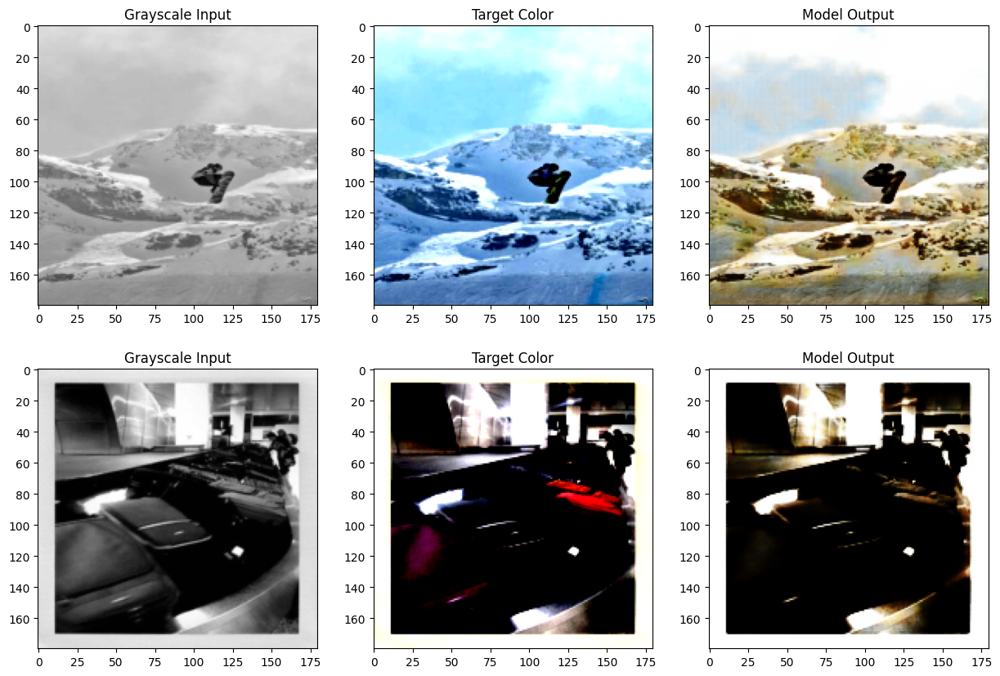

Epoch [41/100], Loss: 0.1941
Epoch [42/100], Loss: 0.1943
Epoch [43/100], Loss: 0.1941
Epoch [44/100], Loss: 0.1942
Epoch [45/100], Loss: 0.1941
Visualizing results after Epoch 45


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9607843..1.3039216].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8333334..1.5].


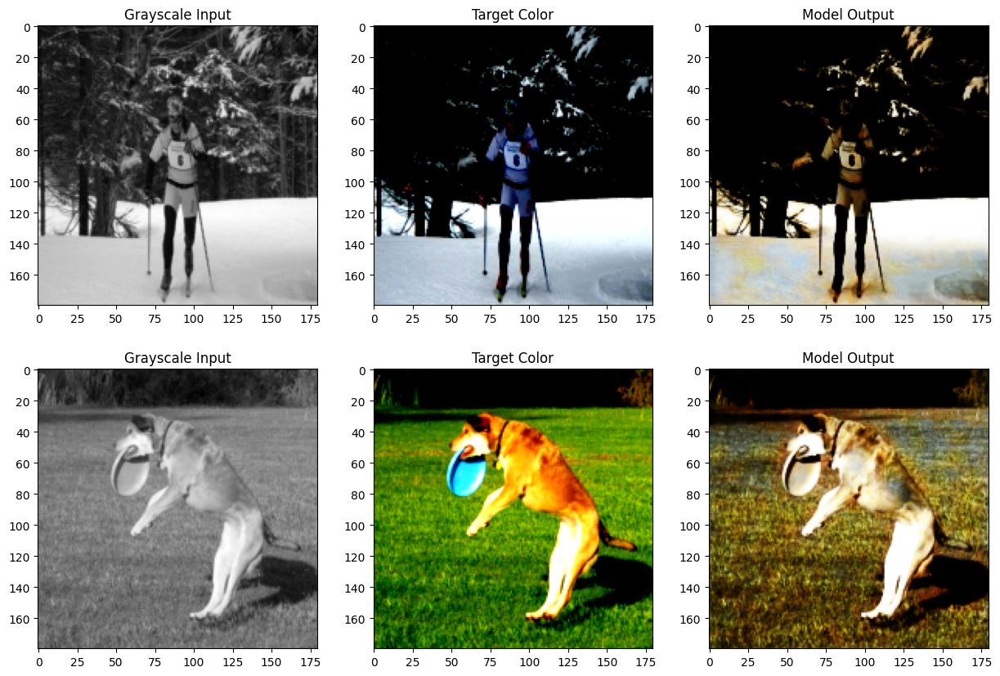

Epoch [46/100], Loss: 0.1943
Epoch [47/100], Loss: 0.1938
Epoch [48/100], Loss: 0.1937
Epoch [49/100], Loss: 0.1942
Epoch [50/100], Loss: 0.1941
Visualizing results after Epoch 50


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.5].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.5].


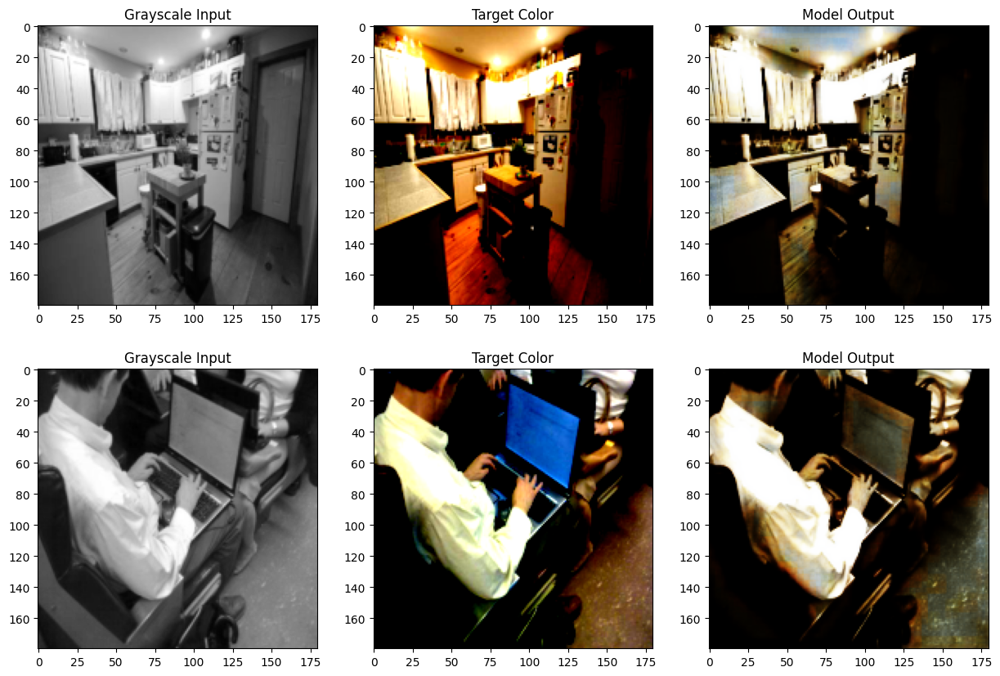

Epoch [51/100], Loss: 0.1940
Epoch [52/100], Loss: 0.1943
Epoch [53/100], Loss: 0.1940
Epoch [54/100], Loss: 0.1941
Epoch [55/100], Loss: 0.1937
Visualizing results after Epoch 55


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9411765..1.5].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9313726..1.3725489].


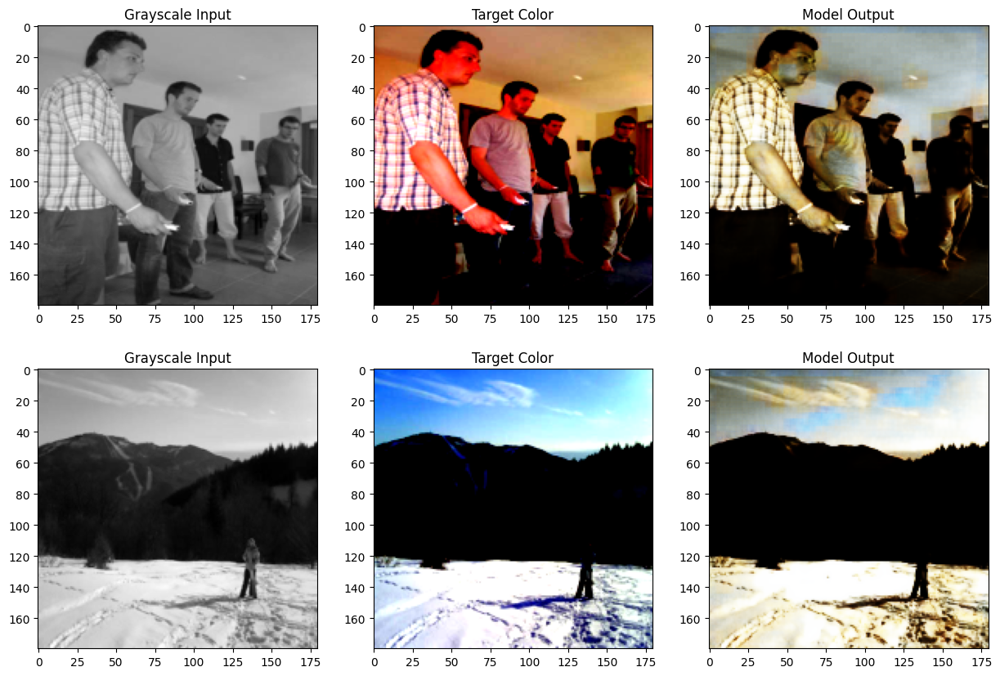

Epoch [56/100], Loss: 0.1938
Epoch [57/100], Loss: 0.1937
Epoch [58/100], Loss: 0.1940
Epoch [59/100], Loss: 0.1938
Epoch [60/100], Loss: 0.1940
Visualizing results after Epoch 60


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.490196].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.84313726..1.490196].


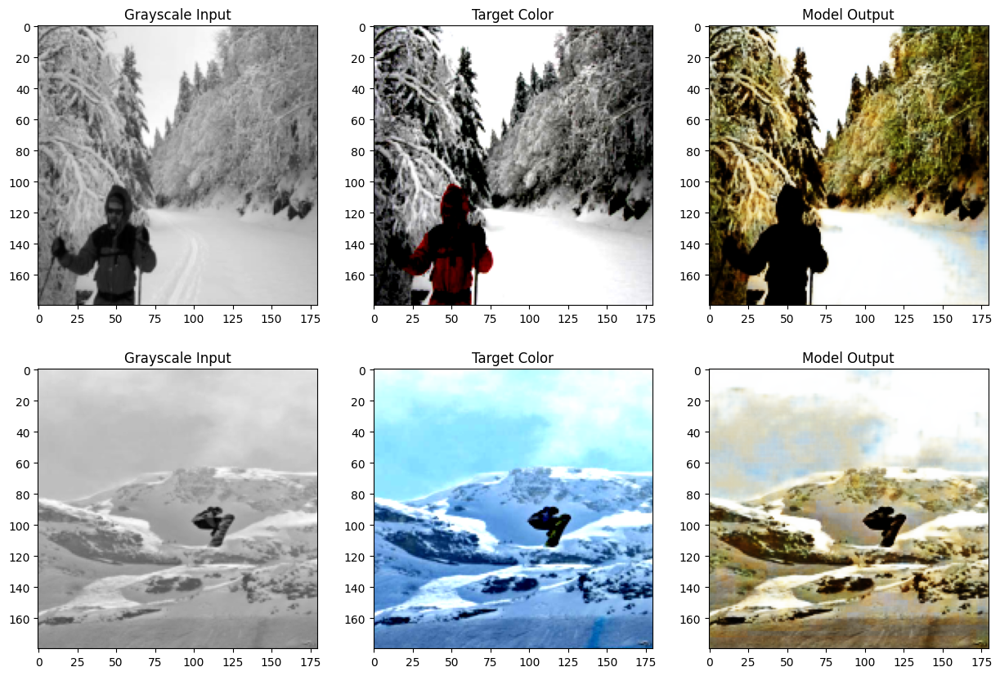

Epoch [61/100], Loss: 0.1937
Epoch [62/100], Loss: 0.1937
Epoch [63/100], Loss: 0.1943
Epoch [64/100], Loss: 0.1938
Epoch [65/100], Loss: 0.1936
Visualizing results after Epoch 65


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.5].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.97058827..1.5].


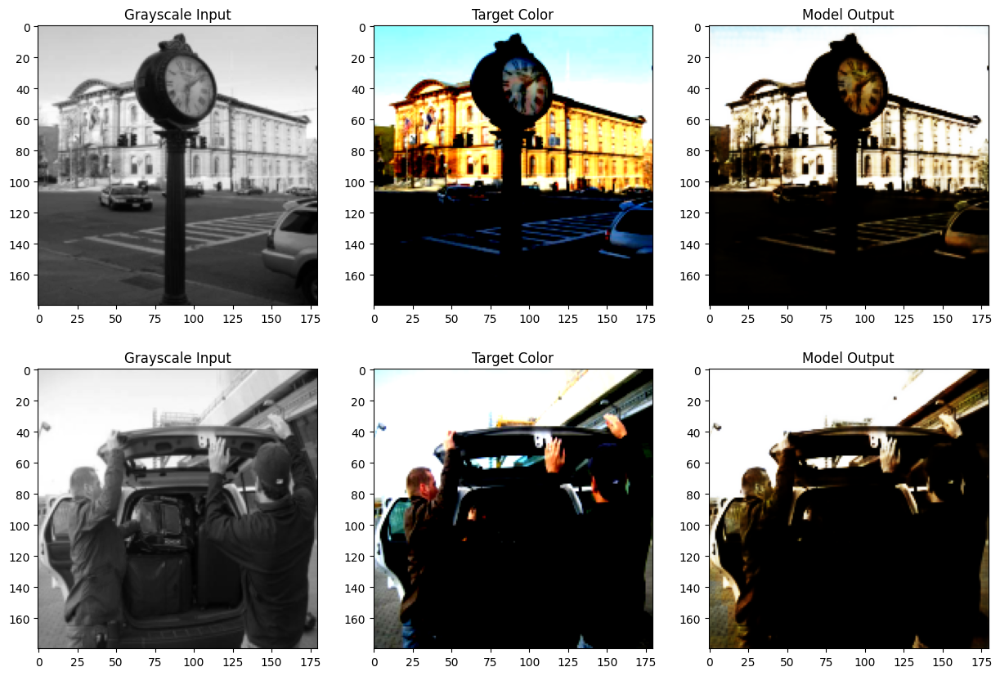

Epoch [66/100], Loss: 0.1938
Epoch [67/100], Loss: 0.1940
Epoch [68/100], Loss: 0.1940
Epoch [69/100], Loss: 0.1940
Epoch [70/100], Loss: 0.1936
Visualizing results after Epoch 70


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.490196].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.5].


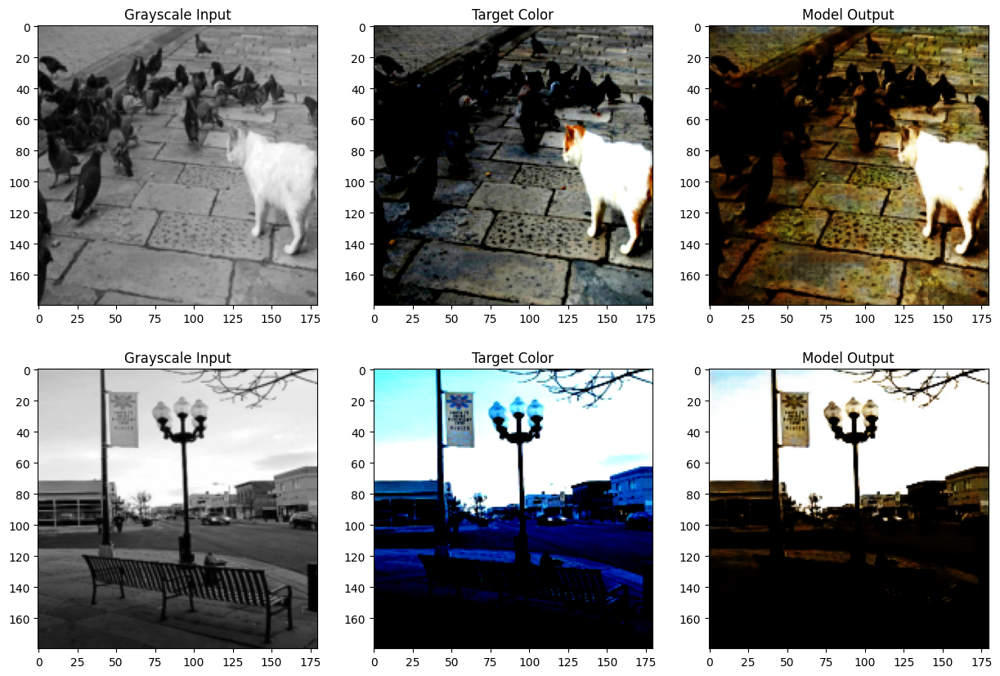

Epoch [71/100], Loss: 0.1936
Epoch [72/100], Loss: 0.1938
Epoch [73/100], Loss: 0.1938
Epoch [74/100], Loss: 0.1936
Epoch [75/100], Loss: 0.1937
Visualizing results after Epoch 75


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.4313724].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.4411765].


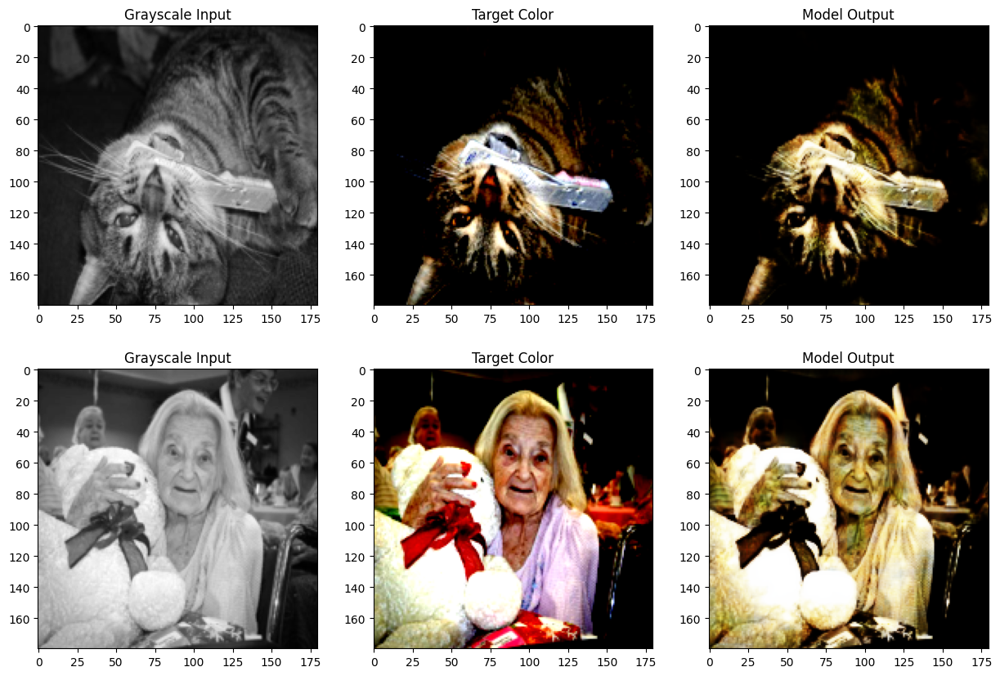

Epoch [76/100], Loss: 0.1937
Epoch [77/100], Loss: 0.1936
Epoch [78/100], Loss: 0.1937
Epoch [79/100], Loss: 0.1936
Epoch [80/100], Loss: 0.1937
Visualizing results after Epoch 80


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.1470588].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.3431373].


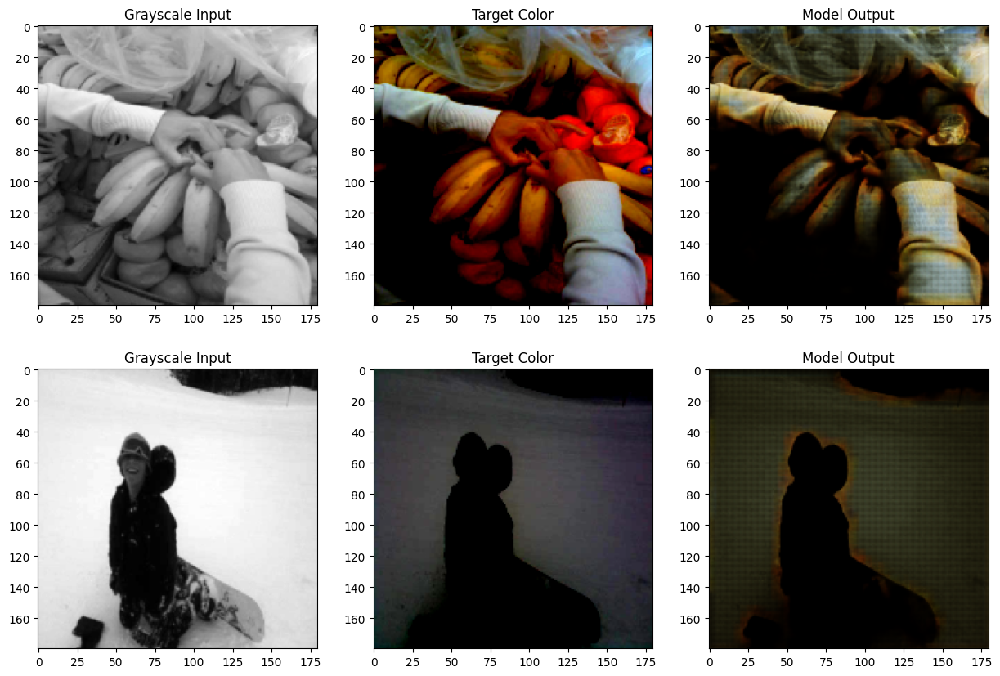

Epoch [81/100], Loss: 0.1935
Epoch [82/100], Loss: 0.1937
Epoch [83/100], Loss: 0.1941
Epoch [84/100], Loss: 0.1938
Epoch [85/100], Loss: 0.1935
Visualizing results after Epoch 85


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.97058827..1.5].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9901961..1.3627452].


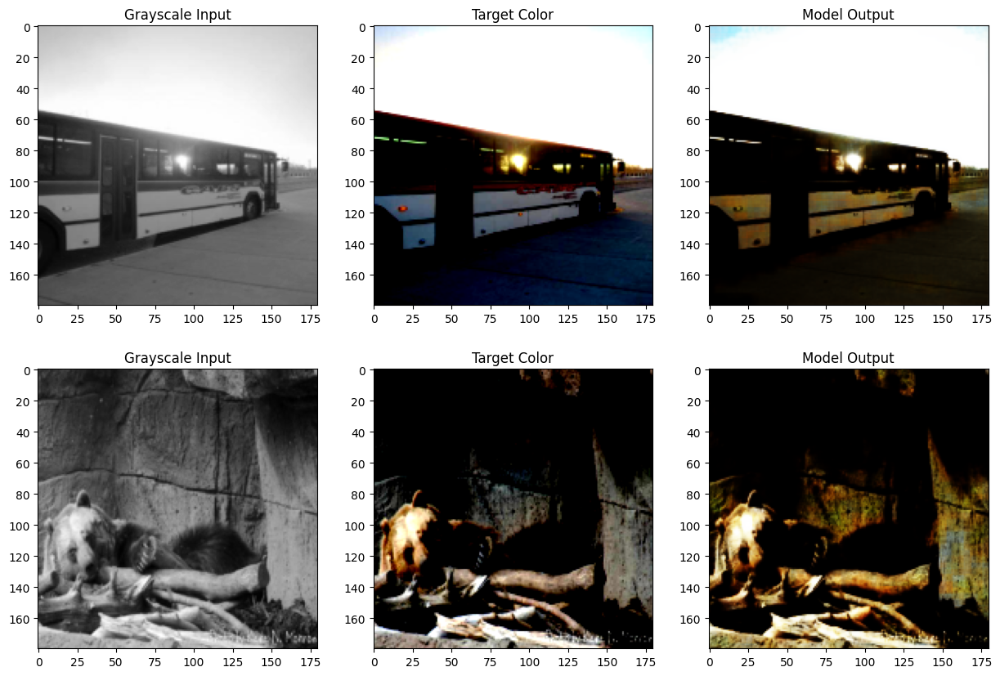

Epoch [86/100], Loss: 0.1937
Epoch [87/100], Loss: 0.1937
Epoch [88/100], Loss: 0.1937
Epoch [89/100], Loss: 0.1937
Epoch [90/100], Loss: 0.1936
Visualizing results after Epoch 90


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.490196].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.4411765].


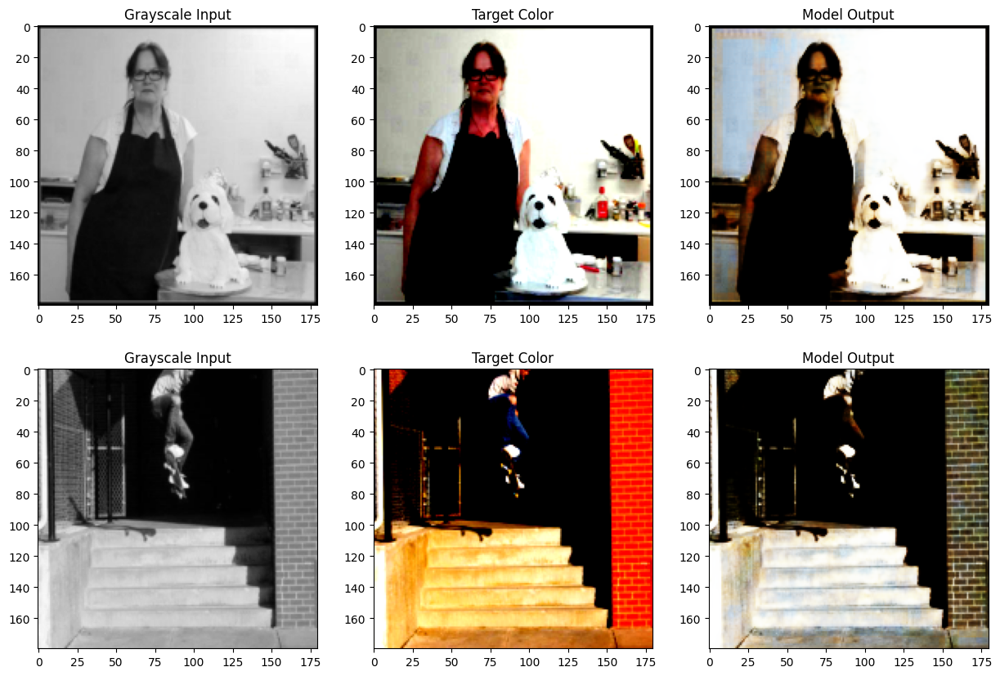

Epoch [91/100], Loss: 0.1933
Epoch [92/100], Loss: 0.1939
Epoch [93/100], Loss: 0.1938
Epoch [94/100], Loss: 0.1936
Epoch [95/100], Loss: 0.1938
Visualizing results after Epoch 95


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.5].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9607843..1.490196].


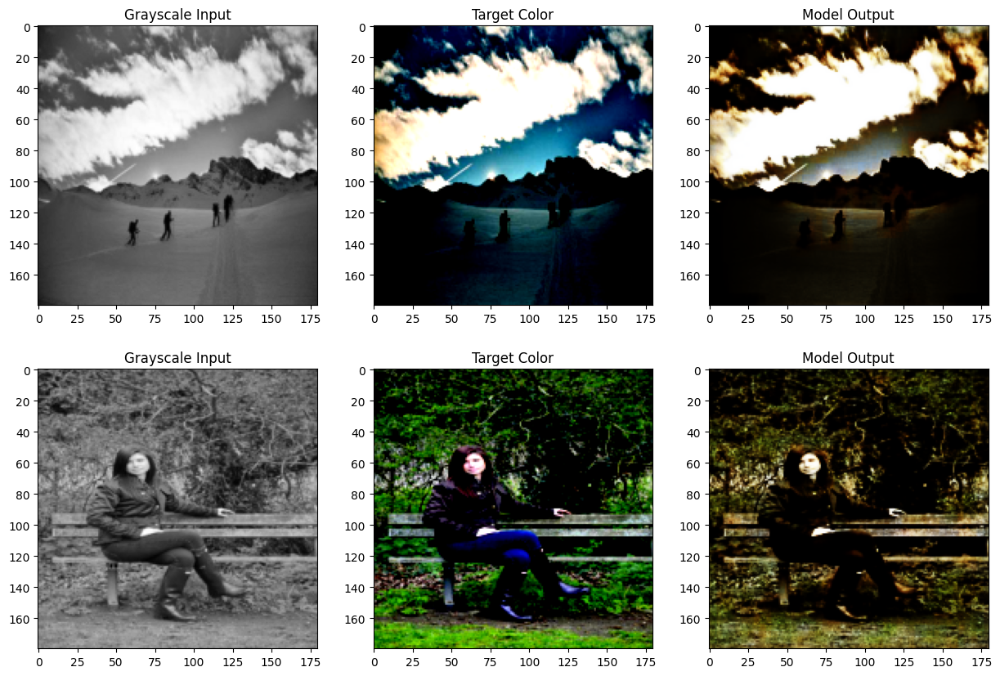

Epoch [96/100], Loss: 0.1936
Epoch [97/100], Loss: 0.1933
Epoch [98/100], Loss: 0.1935
Epoch [99/100], Loss: 0.1935
Epoch [100/100], Loss: 0.1939
Visualizing results after Epoch 100


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.98039216..1.5].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.4313724].


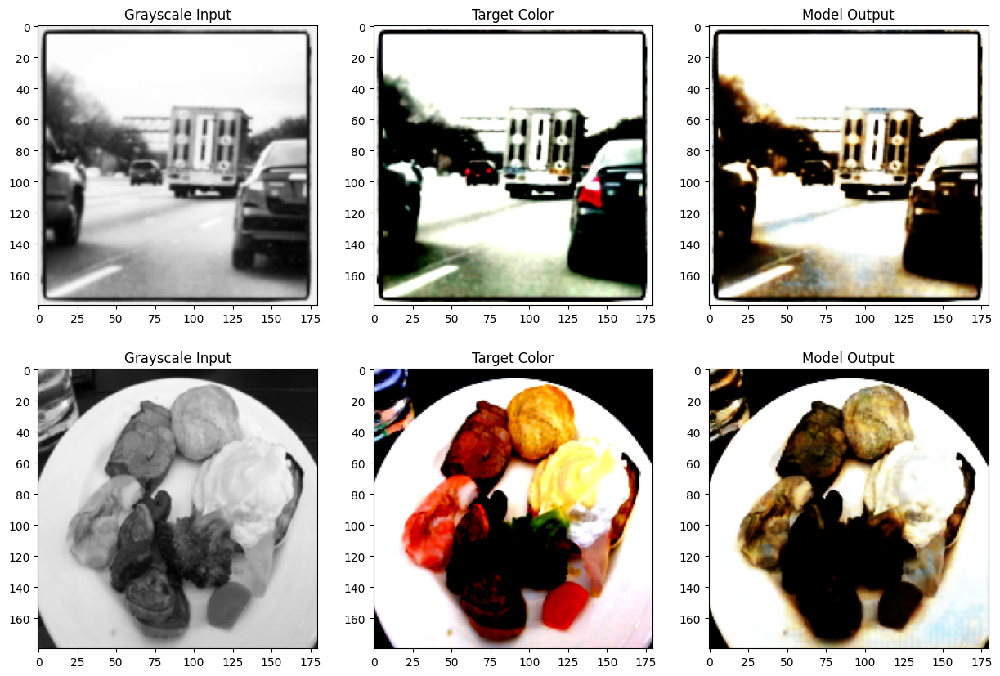

In [19]:



def train_model(model, train_loader, test_loader, num_epochs=50):
    scaler = torch.amp.GradScaler()  # Mixed precision scaler
    best_loss = float('inf')
    early_stopping = EarlyStopping(patience=5, min_delta=0.001)

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        for gray_images, color_images in train_loader:
            gray_images, color_images = gray_images.to(device), color_images.to(device)

            optimizer.zero_grad()

            # Forward pass with mixed precision
            with autocast():
                outputs = model(gray_images)
                loss = criterion(outputs, color_images)

            # Backward pass and optimization
            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()

            running_loss += loss.item()

        # Calculate average loss for the epoch
        epoch_loss = running_loss / len(train_loader)
        print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}")

        # Step the learning rate scheduler
        scheduler.step(epoch_loss)

        # Visualize results after every 5 epochs
        if (epoch + 1) % 5 == 0:
            print(f"Visualizing results after Epoch {epoch+1}")
            visualize_results(model, train_loader, num_images=2)

        # # Early stopping check
        # if early_stopping.step(epoch_loss):
        #     print("Early stopping triggered.")
        #     break

# Example usage
num_epochs = 100
train_model(model, train_loader, test_loader, num_epochs=num_epochs)


In [20]:
import torchvision.models as models

class PerceptualLoss(nn.Module):
    def __init__(self):
        super(PerceptualLoss, self).__init__()
        vgg = models.vgg16(pretrained=True).features[:16].to(device)
        for param in vgg.parameters():
            param.requires_grad = False
        self.vgg = vgg
        self.criterion = nn.MSELoss()

    def forward(self, output, target):
        # Color loss
        color_loss = self.criterion(output, target)
        
        # Perceptual loss
        output_features = self.vgg(output)
        target_features = self.vgg(target)
        perceptual_loss = self.criterion(output_features, target_features)
        
        # Combined loss with weighting
        return color_loss + 0.1 * perceptual_loss

In [21]:
# # 12. Save the Model
# save_dir = "saved_models"
# os.makedirs(save_dir, exist_ok=True)
# model_save_path = os.path.join(save_dir, "colorization_model5.pth")
# torch.save(model.state_dict(), model_save_path)
# print(f"Model saved as {model_save_path}")


In [22]:
# # Save the modelG
torch.save(model
           .state_dict(), 'colorization_model.pth')
print("Model saved as colorization_model.pth")

Model saved as colorization_model.pth


In [23]:
# Compute PSNR and SSIM metrics
def compute_metrics(outputs, targets):
    psnr_total = 0
    ssim_total = 0
    batch_size = outputs.size(0)
    
    for i in range(batch_size):
        output_img = outputs[i].permute(1, 2, 0).cpu().numpy()
        target_img = targets[i].permute(1, 2, 0).cpu().numpy()
        
        # Compute PSNR
        psnr_val = psnr(target_img, output_img, data_range=1.0)
        psnr_total += psnr_val
        
        # Compute SSIM with a smaller window size and specify channel_axis for color images
        ssim_val = ssim(target_img, output_img, data_range=1.0, win_size=3, channel_axis=2)
        ssim_total += ssim_val
        
    avg_psnr = psnr_total / batch_size
    avg_ssim = ssim_total / batch_size
    return avg_psnr, avg_ssim

In [25]:
state_dict = torch.load('colorization_model.pth')
model.load_state_dict(state_dict)

C:\Users\psono\AppData\Local\Temp\ipykernel_17908\1968660518.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load('colorization_model.pth')


<All keys matched successfully>

In [26]:
def test_model(model, test_loader, criterion):
    model.eval()  # Set model to evaluation mode
    test_loss = 0.0
    psnr_total = 0.0
    ssim_total = 0.0
    batch_count = 0

    with torch.no_grad():  # Disable gradient calculation for testing
        for gray_images, color_images in test_loader:
            gray_images, color_images = gray_images.to(device), color_images.to(device)
            outputs = model(gray_images)
            loss = criterion(outputs, color_images)
            test_loss += loss.item()

            # Compute PSNR and SSIM for the current batch
            psnr_val, ssim_val = compute_metrics(outputs, color_images)
            psnr_total += psnr_val
            ssim_total += ssim_val
            batch_count += 1
    
    avg_test_loss = test_loss / len(test_loader)
    avg_psnr = psnr_total / batch_count
    avg_ssim = ssim_total / batch_count
    return avg_test_loss, avg_psnr, avg_ssim

<!--  -->

In [27]:
# Calculate and print test metrics
test_loss, test_psnr, test_ssim = test_model(model, test_loader, criterion)
print(f"Test Loss (MSE): {test_loss:.4f}")
print(f"Test PSNR: {test_psnr:.2f} dB")
print(f"Test SSIM: {test_ssim:.4f}")

Test Loss (MSE): 0.1897
Test PSNR: 8.07 dB
Test SSIM: 0.3446


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.5].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.98039216..1.2647059].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9901961..1.4607843].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.5].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.87254906..1.490196].


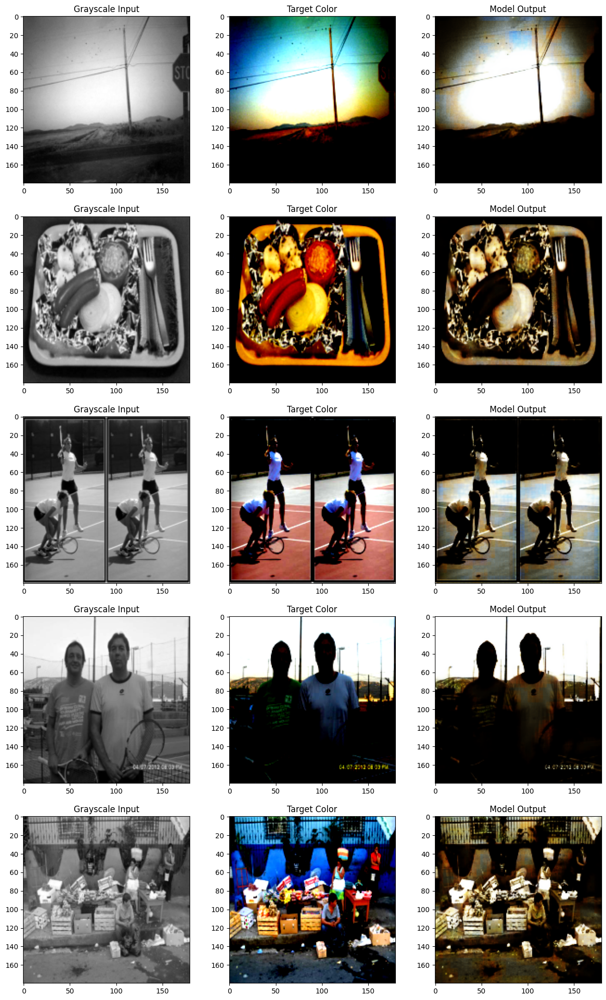

In [28]:
visualize_results(model, test_loader, num_images=5)